In [4]:
import pandas as pd
import datetime as dt
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import plotly.express as px
import seaborn as sns
from sklearn.decomposition import PCA
from entsoe import EntsoePandasClient
from statsmodels.graphics import tsaplots
from pandas_profiling import ProfileReport
import os
%matplotlib inline

In [3]:
%%capture
%load_ext autoreload
%autoreload all
from functions import *
from __init__ import root_dir, data_path

In [5]:
df = pd.read_csv(os.path.join(data_path,'clean','clean_lagged.csv'), parse_dates= ['Timestamp','Date'])
df.head()

,Timestamp,DK_1_imports,SE_4_imports,DK_1_exports,SE_4_exports,Day_Ahead_price,Forecasted_Load,Actual_Load,Solar_[MW],ttf_price,...,Hour,Week,business,Wind Total,DAP-lag24,DAP-lag36,DAP-lag48,DAP-lag72,DAP-lag168,DAP-lag-168
0,2018-01-02 00:00:00,383.0,0.0,0.0,808.0,18.12,1258.0,1245.0,0.0,19.32,...,0,1,True,429.0,NaN,NaN,NaN,NaN,NaN,27.17
1,2018-01-02 01:00:00,589.0,0.0,0.0,1019.0,14.99,1188.0,1203.0,0.0,19.32,...,1,1,True,375.0,NaN,NaN,NaN,NaN,NaN,22.10
2,2018-01-02 02:00:00,557.0,0.0,0.0,926.0,17.79,1167.0,1178.0,0.0,19.32,...,2,1,True,313.0,NaN,NaN,NaN,NaN,NaN,9.79
3,2018-01-02 03:00:00,487.0,0.0,0.0,784.0,24.51,1187.0,1180.0,0.0,19.32,...,3,1,True,229.0,NaN,NaN,NaN,NaN,NaN,4.99
4,2018-01-02 04:00:00,580.0,0.0,0.0,756.0,17.82,1235.0,1247.0,0.0,19.32,...,4,1,True,175.0,NaN,NaN,NaN,NaN,NaN,9.24


## Creating df for imports and exports

In [6]:
df_import_export = df.copy()
df_import_export['imports'] = df['DK_1_imports'] + df['SE_4_imports'] + df['DE_LU_AT_imports']
df_import_export['exports'] = df['DK_1_exports'] + df['SE_4_exports'] + df['DE_LU_AT_exports']
df_import_export.head()

,Timestamp,DK_1_imports,SE_4_imports,DK_1_exports,SE_4_exports,Day_Ahead_price,Forecasted_Load,Actual_Load,Solar_[MW],ttf_price,...,business,Wind Total,DAP-lag24,DAP-lag36,DAP-lag48,DAP-lag72,DAP-lag168,DAP-lag-168,imports,exports
0,2018-01-02 00:00:00,383.0,0.0,0.0,808.0,18.12,1258.0,1245.0,0.0,19.32,...,True,429.0,NaN,NaN,NaN,NaN,NaN,27.17,983.0,808.0
1,2018-01-02 01:00:00,589.0,0.0,0.0,1019.0,14.99,1188.0,1203.0,0.0,19.32,...,True,375.0,NaN,NaN,NaN,NaN,NaN,22.10,1189.0,1019.0
2,2018-01-02 02:00:00,557.0,0.0,0.0,926.0,17.79,1167.0,1178.0,0.0,19.32,...,True,313.0,NaN,NaN,NaN,NaN,NaN,9.79,1157.0,926.0
3,2018-01-02 03:00:00,487.0,0.0,0.0,784.0,24.51,1187.0,1180.0,0.0,19.32,...,True,229.0,NaN,NaN,NaN,NaN,NaN,4.99,1087.0,784.0
4,2018-01-02 04:00:00,580.0,0.0,0.0,756.0,17.82,1235.0,1247.0,0.0,19.32,...,True,175.0,NaN,NaN,NaN,NaN,NaN,9.24,1180.0,756.0


In [7]:
df_2023 = df.copy()
df_2023.columns

Index(['Timestamp', 'DK_1_imports', 'SE_4_imports', 'DK_1_exports',
       'SE_4_exports', 'Day_Ahead_price', 'Forecasted_Load', 'Actual_Load',
       'Solar_[MW]', 'ttf_price', 'coal_price', 'co2_price',
       'Biomass_Actual_Aggregated_[MW]', 'Waste_Actual_Aggregated_[MW]',
       'DE_LU_AT_imports', 'DE_LU_AT_exports', 'Year', 'Quarter', 'Month',
       'Date', 'Day', 'Weekday', 'Hour', 'Week', 'business', 'Wind Total',
       'DAP-lag24', 'DAP-lag36', 'DAP-lag48', 'DAP-lag72', 'DAP-lag168',
       'DAP-lag-168'],
      dtype='object')

In [8]:
df.describe()

,DK_1_imports,SE_4_imports,DK_1_exports,SE_4_exports,Day_Ahead_price,Forecasted_Load,Actual_Load,Solar_[MW],ttf_price,coal_price,...,Weekday,Hour,Week,Wind Total,DAP-lag24,DAP-lag36,DAP-lag48,DAP-lag72,DAP-lag168,DAP-lag-168
count,46313.000000,46313.000000,46313.000000,46313.000000,46313.000000,46313.000000,46313.000000,46313.000000,46313.000000,46313.000000,...,46313.000000,46313.000000,46313.000000,46313.000000,46289.000000,46277.000000,46265.000000,46241.000000,46145.000000,46145.000000
mean,295.602379,487.771015,63.370522,126.041673,83.225687,1517.180360,1517.147820,48.759182,45.537741,153.167625,...,2.999892,11.499665,25.613715,350.955023,83.238602,83.227941,83.214979,83.217198,83.229082,83.411471
std,238.036480,440.321724,145.468765,289.337762,98.386951,300.331878,298.560629,81.927662,51.730563,115.259587,...,1.998720,6.922102,15.278307,283.875963,98.408801,98.418882,98.427726,98.448628,98.530678,98.515801
min,0.000000,0.000000,0.000000,0.000000,-48.290000,750.000000,815.000000,0.000000,3.510000,48.500000,...,0.000000,0.000000,1.000000,0.000000,-48.290000,-48.290000,-48.290000,-48.290000,-48.290000,-48.290000
25%,13.000000,11.000000,0.000000,0.000000,33.380000,1291.000000,1294.000000,0.000000,14.320000,70.000000,...,1.000000,5.000000,12.000000,105.000000,33.370000,33.370000,33.360000,33.360000,33.360000,33.470000
50%,303.000000,406.000000,0.000000,0.000000,47.530000,1519.000000,1519.000000,1.000000,21.540001,101.750000,...,3.000000,12.000000,25.000000,277.000000,47.530000,47.520000,47.520000,47.510000,47.470000,47.680000
75%,561.000000,890.000000,6.000000,34.000000,87.520000,1727.000000,1722.000000,67.000000,65.102997,180.000000,...,5.000000,17.000000,39.000000,554.000000,87.550000,87.390000,87.260000,87.250000,87.040000,87.980000
max,700.000000,1558.000000,603.000000,1743.000000,871.000000,2430.000000,6385.000000,643.000000,339.196014,457.800000,...,6.000000,23.000000,53.000000,1480.000000,871.000000,871.000000,871.000000,871.000000,871.000000,871.000000


### Using Pandas-profiling

For further data exploration, Pandas-profilinig library will be imported and used. pandas.DataFrame.describe() does the basic EDA of the dataset and Pandas-profiling extends the analysis of the dataframe for getting a complete report

In [9]:
profile = ProfileReport(df, title="Denmark Electricity prices and other values", html={'style': {'full_width': True}})

In [ ]:
profile.to_notebook_iframe()

Summarize dataset:  94%|█████████████████████████████████████████████████████████████████████████████████████████▌     | 776/823 [02:30<00:08,  5.50it/s, scatter DE_LU_AT_exports, DAP-lag168]

# Line chart of electricity price over time

Here we are ploting a line chart of Electricity Prices, Natural Gas Price and CO2 Price over time.
This helps us see the change and trends and sesonality over time.

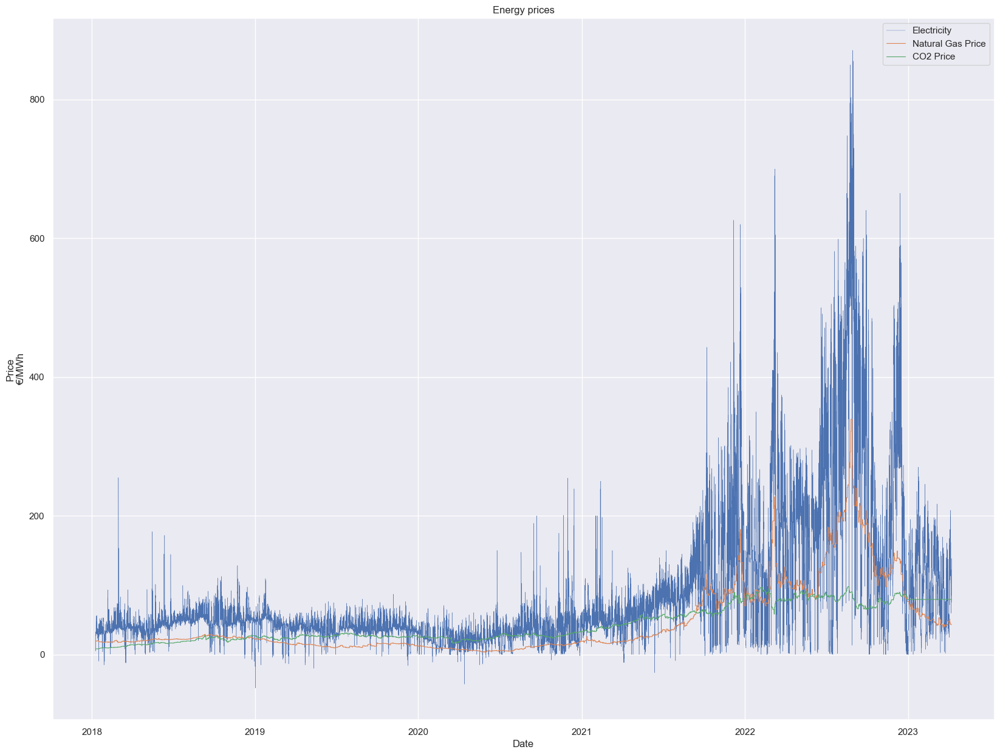

In [29]:
# Line chart of electricity price over time

plt.figure(figsize = (20,15))

plt.plot(df['Timestamp'], df_2023['Day_Ahead_price'], linestyle = '-', linewidth = 0.3, label = 'Electricity')
plt.plot(df['Timestamp'], df_2023['ttf_price'], linestyle = '-', linewidth = 0.8, label = 'Natural Gas Price')
plt.plot(df['Timestamp'], df_2023['co2_price'], linestyle = '-', linewidth = 0.8, label = 'CO2 Price')
plt.legend()
plt.title('Energy prices')
plt.xlabel('Date')
plt.ylabel('Price\n€/MWh')

plt.show()

In [ ]:
# Here we are making a df2 in order to use for the plots, and have the freedom to change it without affecting the original Dataframe, also adding Months and Quarters of the years

df2 = df.copy()

months = df['Month'].unique()
quarters = df['Quarter'].unique()
years = [2018, 2019, 2020, 2021, 2022]

#Making a list for all years in order to plot specifically
list_years = list(set(df['Year']))

## Only Day Ahead Price over time

This is a plot of Day ahead price only for all the years

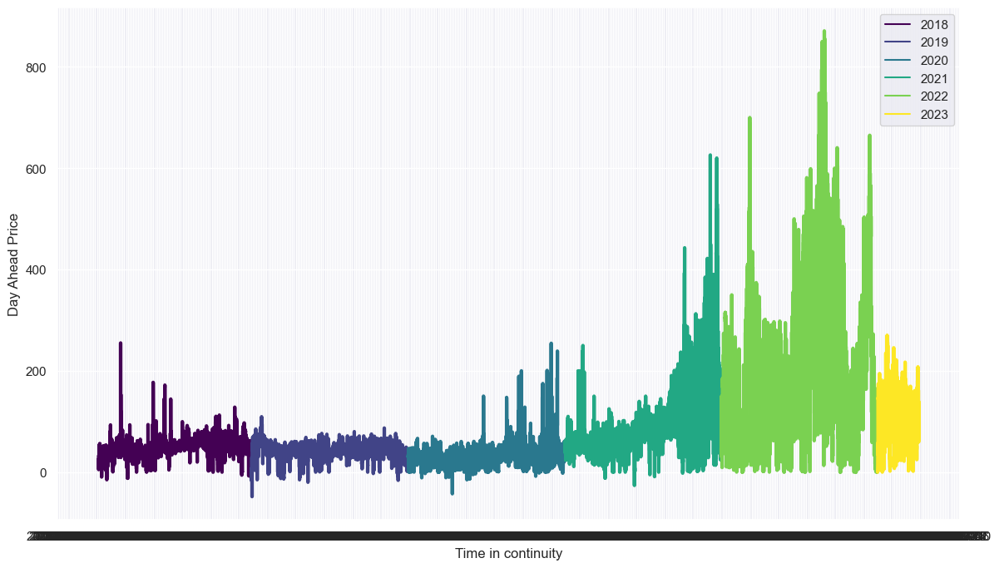

In [31]:
sns.set_style('darkgrid')
sns.set(rc={'figure.figsize':(14,8)})

ax = sns.lineplot(data=df, x ='Timestamp', y = 'Day_Ahead_price',
                  hue='Year', palette='viridis',
                  legend='full', lw=3)

ax.xaxis.set_major_locator(ticker.MultipleLocator(4))
plt.legend(bbox_to_anchor=(1, 1))
plt.ylabel('Day Ahead Price')
plt.xlabel('Time in continuity')
plt.show()

## Import the necessaries libraries

#!!! Important that if connection is not stable or in random times you need to have it so you can plot the interactive plots



In [33]:
import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()

## Day Ahead Price over time with Interactive Graph

This is the same as the previous one, but we can interact with all the years to see one or two specifically and it is easier to make comparisons between years as well. 

In [34]:
import plotly.graph_objects as go

#extract color palette, the palette can be changed
pal = list(sns.color_palette(palette='viridis', n_colors=len(list_years)).as_hex())

fig = go.Figure()
for d,p in zip(list_years, pal):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Day_Ahead_price'],
                             name = str(d) +' Day Ahead Price',
                             line_color = p, 
                             fill=None))   #tozeroy 
    


fig.show()
fig.write_html("Day Ahead Price in Time.html")


## All the renewable Sources and the Actual Electrecity Load

Here we have all the electricity sources that are renewable ove time, we can also choose which one to see if we choose for example to speak and give insights about one renewable
source according to demand of the audience.

In [35]:
pal1 = list(sns.color_palette(palette='viridis', n_colors=len(list_years)).as_hex())
pal2 = list(sns.color_palette(palette='YlOrBr', n_colors=len(list_years)).as_hex())
pal3 = list(sns.color_palette(palette='plasma', n_colors=len(list_years)).as_hex())

fig = go.Figure()
for d,p in zip(list_years, pal):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Actual_Load'],
                             name = str(d) + " Actual Load",
                             line_color = p, 
                             fill=None))   #tozeroy 
    

for d,p in zip(list_years, pal2):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Wind Total'],
                             name = str(d) + ' Wind Total',
                             line_color = p, 
                             fill=None))   #tozeroy 

for d,p in zip(list_years, pal3):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Solar_[MW]'],
                             name = str(d) + ' Solar',
                             line_color = p, 
                             fill=None))   #tozeroy 
    
for d,p in zip(list_years, pal2):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Biomass_Actual_Aggregated_[MW]'],
                             name = str(d) + ' Biomass Renewable',
                             line_color = p, 
                             fill=None))   #tozeroy

for d,p in zip(list_years, pal1):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Waste_Actual_Aggregated_[MW]'],
                             name = str(d) + ' Waste Renewable',
                             line_color = p, 
                             fill=None))   #tozeroy 
    


fig.show()

## Creating a new dataframe with all the renewable sources and the Actual Load of the Electricity Network

In [37]:
df_renew = df[['Timestamp','Year','Wind Total','Solar_[MW]','Biomass_Actual_Aggregated_[MW]',
              'Waste_Actual_Aggregated_[MW]','Actual_Load']].copy()

df_renew['Total Renewable'] = (df_renew['Wind Total'] 
                               + df_renew['Solar_[MW]'] 
                               + df_renew['Biomass_Actual_Aggregated_[MW]'] 
                               + df_renew['Waste_Actual_Aggregated_[MW]'])

##  Stackplot for every year all the Renewable sources

Using a stack plot helps seeing the difference of each source and how much it adds to the total sum of Renewables

In [1]:

for yr in years:
        df_temp = df_renew[df_renew['Year'] == yr]
        df_temp.set_index('Timestamp',inplace = True)
        i = df_temp.groupby(pd.Grouper(freq="M")).sum()
    # Stackplot with X, Y, colors value
        plt.stackplot(i.index, i['Wind Total'], i['Solar_[MW]'],
                    i['Biomass_Actual_Aggregated_[MW]'], i['Waste_Actual_Aggregated_[MW]'],
                      colors =['r','orange','g','b','c'])

    # Days
        plt.xlabel('Time Window')

    # Production
        plt.ylabel('Electricity Production')
        plt.legend()
    # Title of Graph
        plt.title('Representation of Renewable Sources production over time ' +str(yr))

    # Displaying Graph
        plt.legend(i.columns[1:])
        plt.show()

NameError: name 'years' is not defined

# Stackplot for Renewables over all the time frame

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


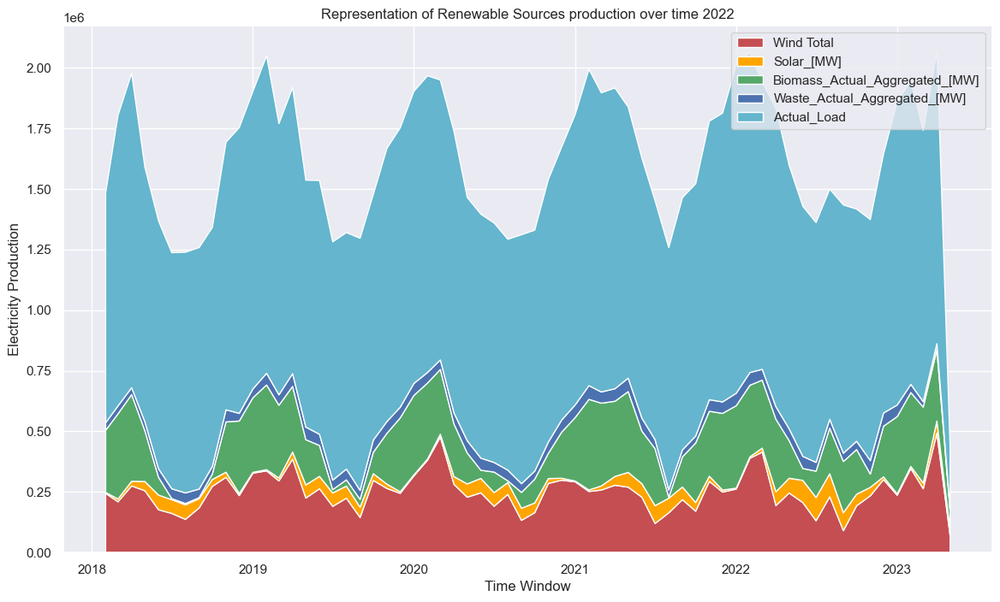

In [46]:
df_temp = df_renew.copy()
df_temp.set_index('Timestamp',inplace = True)
i = df_temp.groupby(pd.Grouper(freq="M")).sum()
#     # Stackplot with X, Y, colors value
plt.stackplot(i.index, i['Wind Total'], i['Solar_[MW]'],
                    i['Biomass_Actual_Aggregated_[MW]'], i['Waste_Actual_Aggregated_[MW]'],i['Actual_Load'],
                      colors =['r','orange','g','b','c'])

    # Days
plt.xlabel('Time Window')

    # Production
plt.ylabel('Electricity Production')
plt.legend()
    # Title of Graph
plt.title('Representation of Renewable Sources production over time ' +str(yr))

    # Displaying Graph
plt.legend(i.columns[1:])
plt.show()

In [67]:
df3.columns

Index(['Date', 'Day_Ahead_price', 'ttf_price', 'co2_price'], dtype='object')

## Sum of Renewable electricity Production Sources and the total Load of the Electricity Network
So now we plot the total sum of Renewable electricity Production Sources and the total Load of the Electricity Network,
this helps us see how much these two number are in space.

In [47]:
pal = list(sns.color_palette(palette='viridis', n_colors=len(list_years)).as_hex())
pal2 = list(sns.color_palette(palette='Spectral', n_colors=len(list_years)).as_hex())

fig = go.Figure()
for d,p in zip(list_years, pal):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Actual_Load'],
                             name = 'Actual Load needed of year ' + str(d),
                             line_color = p, 
                             fill=None))   #tozeroy 
    

for d,p in zip(list_years, pal2):
    fig.add_trace(go.Scatter(x = df_renew[df_renew['Year']==d]['Timestamp'],
                             y = df_renew[df_renew['Year']==d]['Total Renewable'],
                             name = 'Renewable Energy of ' + str(d),
                             line_color = p, 
                             fill=None))   #tozeroy
    


fig.show()
fig.write_html("Load + Renewables.html")

In [54]:
df_import_export = df.copy()
df_import_export['imports'] = df['DK_1_imports'] + df['SE_4_imports'] + df['DE_LU_AT_imports']
df_import_export['exports'] = df['DK_1_exports'] + df['SE_4_exports'] + df['DE_LU_AT_exports']

df_import_export
#Making a list for all years in order to plot specifically
list_years2 = list(set(df['Year']))

## This is the Plot of the total Imports and Exports of East Denmark (zone DK2)

In [55]:
pal3 = list(sns.color_palette(palette='inferno', n_colors=len(list_years2)).as_hex())
pal4 = list(sns.color_palette(palette='viridis', n_colors=len(list_years2)).as_hex())

fig = go.Figure()

for d,p in zip(list_years2, pal4):
    fig.add_trace(go.Scatter(x = df_import_export[df_import_export['Year']==d]['Timestamp'],
                             y = df_import_export[df_import_export['Year']==d]['imports'],
                             name = str(d) +' Total Import',
                             line_color = p, 
                             fill='tozeroy'))   #tozeroy 
    
for d,p in zip(list_years, pal3):
    fig.add_trace(go.Scatter(x = df_import_export[df_import_export['Year']==d]['Timestamp'],
                             y = df_import_export[df_import_export['Year']==d]['exports'],
                             name = str(d) +' Total Export',
                             line_color = p, 
                             fill='tozeroy'))   #tozeroy 

fig.show()

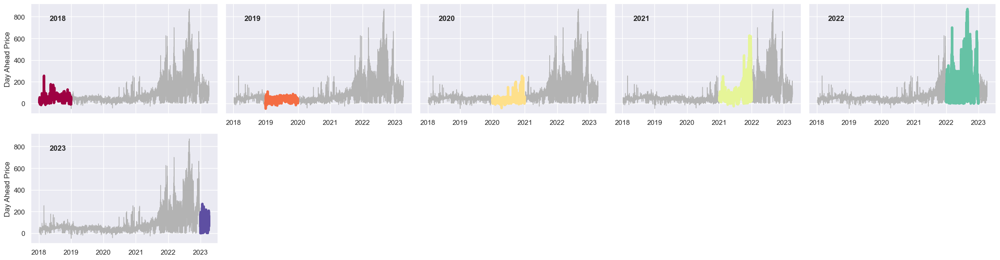

In [49]:
g = sns.relplot(data = df, x = "Timestamp", y = 'Day_Ahead_price',
                col = "Year", hue = "Year",
                kind = "line", palette = "Spectral",   
                linewidth = 4, zorder = 5,
                col_wrap = 5, height = 3, aspect = 1.5, legend = False
               )

#add text and silhouettes
for time, ax in g.axes_dict.items():
    ax.text(.1, .85, time,
            transform = ax.transAxes, fontweight="bold"
           )
    sns.lineplot(data = df, x = "Timestamp", y = 'Day_Ahead_price', units="Year",
                 estimator = None, color= ".7", linewidth=1, ax=ax
                )

g.set_titles("")
g.set_axis_labels("", "Day Ahead Price")
g.tight_layout()

## Renewable Energy (Total) for all per 2 Months for all the Years.

In [56]:
# plotting the histogram
fig = px.histogram(df_renew, x="Timestamp",y = 'Total Renewable', color='Year',
                   nbins=50, histnorm='percent',
                   barmode='overlay')
 
# showing the plot
fig.show()

# Day Ahead Price for all years under the same X axis

To make difference for all the years more evident. We can safely say that there is an increase, especially since 2022 summer.

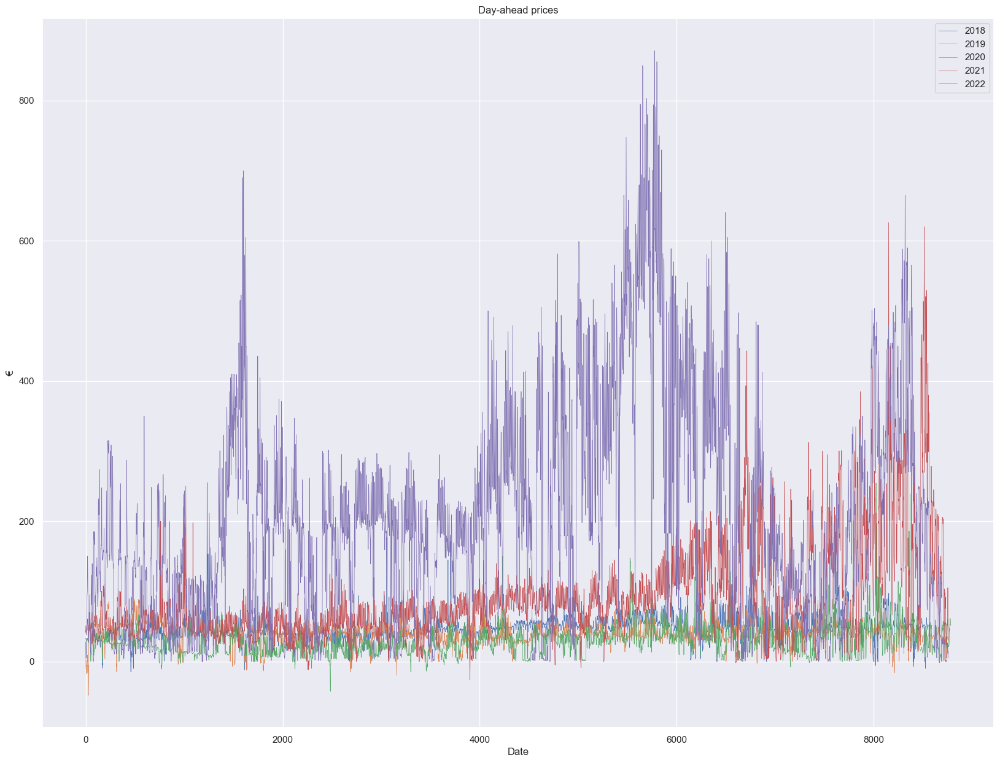

In [57]:
plt.figure(figsize = (20,15))
for yr in years:
    plt.plot(df2[df2['Year'] == yr].reset_index()['Day_Ahead_price'], linewidth = 0.5, label = yr)
plt.title('Day-ahead prices')
plt.xlabel('Date')
plt.ylabel('€')
plt.legend()
plt.show()

In [2]:
## The price of Natual Gas over Time

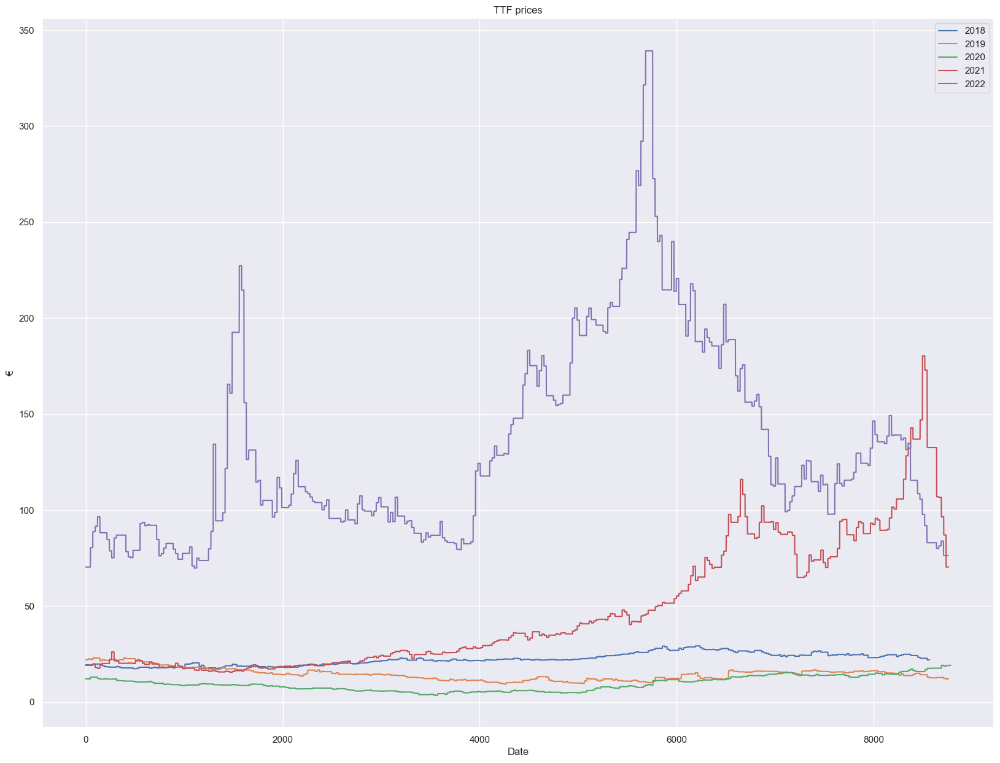

In [58]:
plt.figure(figsize = (20,15))
for yr in years:
    plt.plot(df2[df2['Year'] == yr].reset_index()['ttf_price'], label = yr)
plt.title('Natural Gas Price')
plt.xlabel('Date')
plt.ylabel('€')
plt.legend()
plt.show()

,Date,Day_Ahead_price,ttf_price,co2_price
0,2018-01-09,27.167500,19.434999,8.19
1,2018-01-10,40.407083,19.325001,8.28
2,2018-01-11,43.836667,19.320000,8.21
3,2018-01-12,36.380000,19.805000,8.26
4,2018-01-13,31.123750,19.805000,8.26
...,...,...,...,...
1910,2023-04-03,114.894583,51.367001,79.40
1911,2023-04-04,132.763750,46.568001,79.40
1912,2023-04-05,141.247083,44.575001,79.40
1913,2023-04-06,115.450417,43.125000,79.40


## Mean Day Ahead prices of the hours

It is evident by the data that there is a trend for some hours of the day.
This could help us predict the Future price and even load of the future electricity networks.

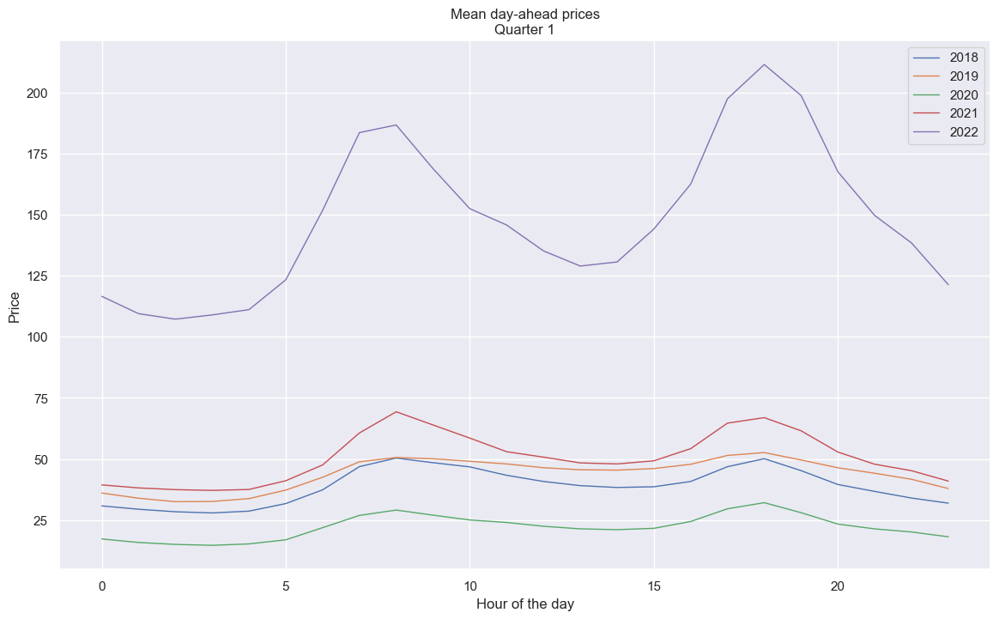

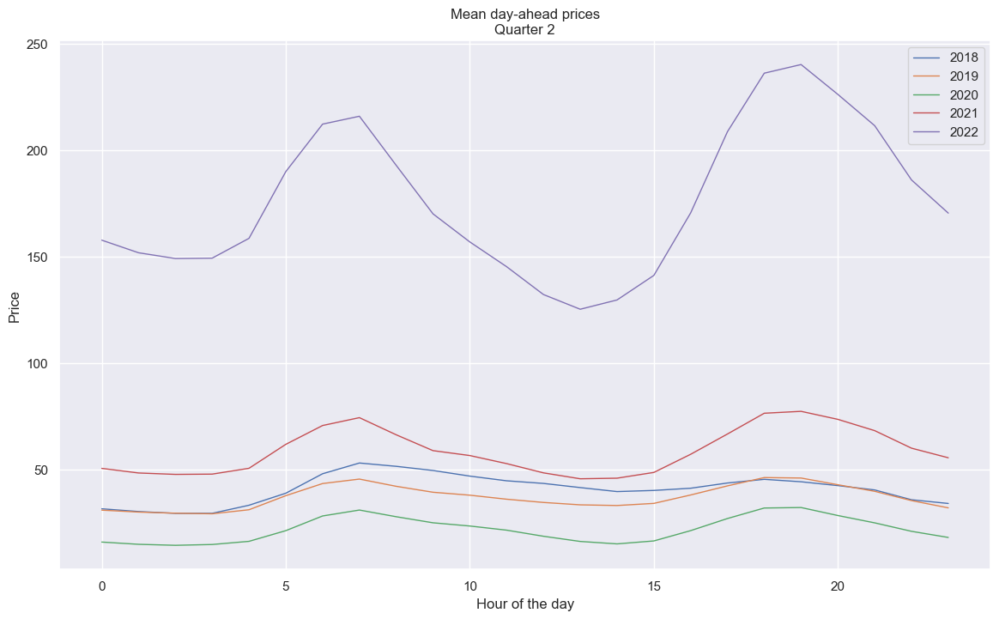

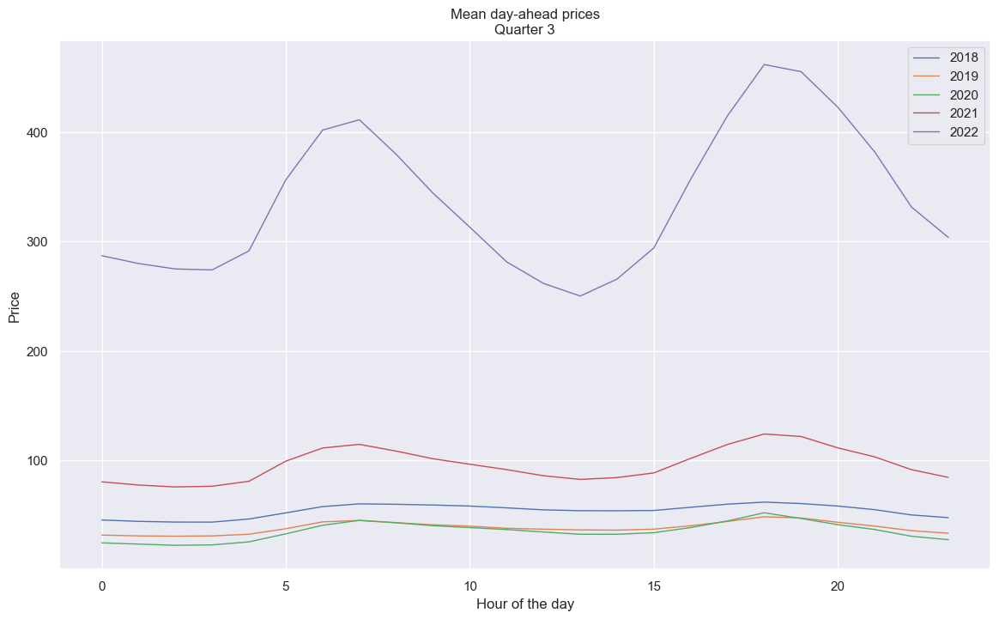

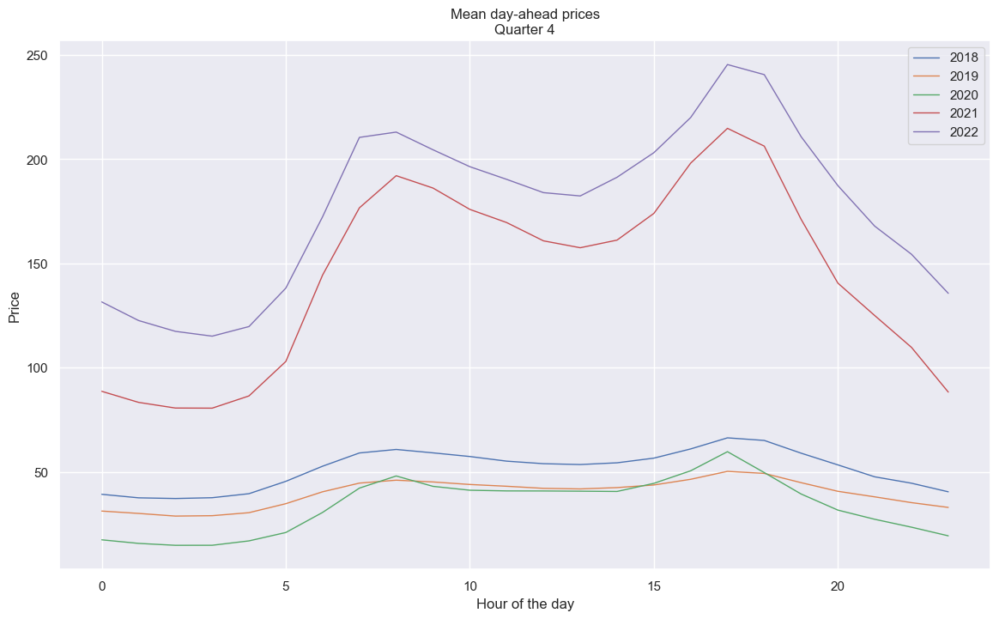

In [77]:
for q in quarters:
    for y in years:
        temp = df2[(df2['Year'] == y) & (df2['Quarter'] == q)].reset_index()
        temp = temp.groupby('Hour').mean(numeric_only = True)
        plt.plot(temp['Day_Ahead_price'], linestyle = '-', linewidth = 1, label = y)
    plt.legend()
    plt.title('Mean day-ahead prices\nQuarter '+str(q))
    plt.xlabel('Hour of the day')
    plt.ylabel('Price')
    plt.show()

## Mean Day Ahead prices of the load

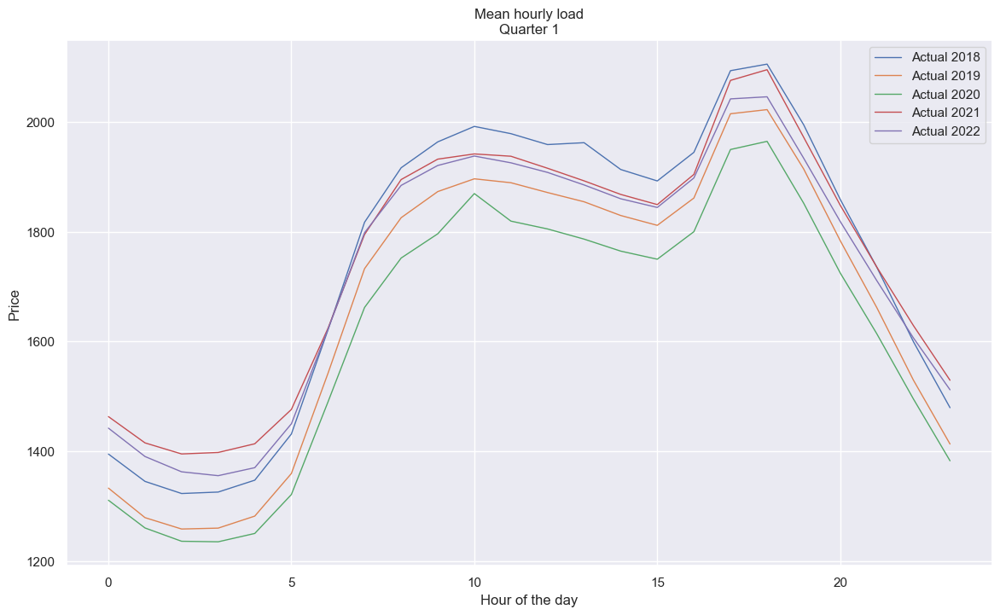

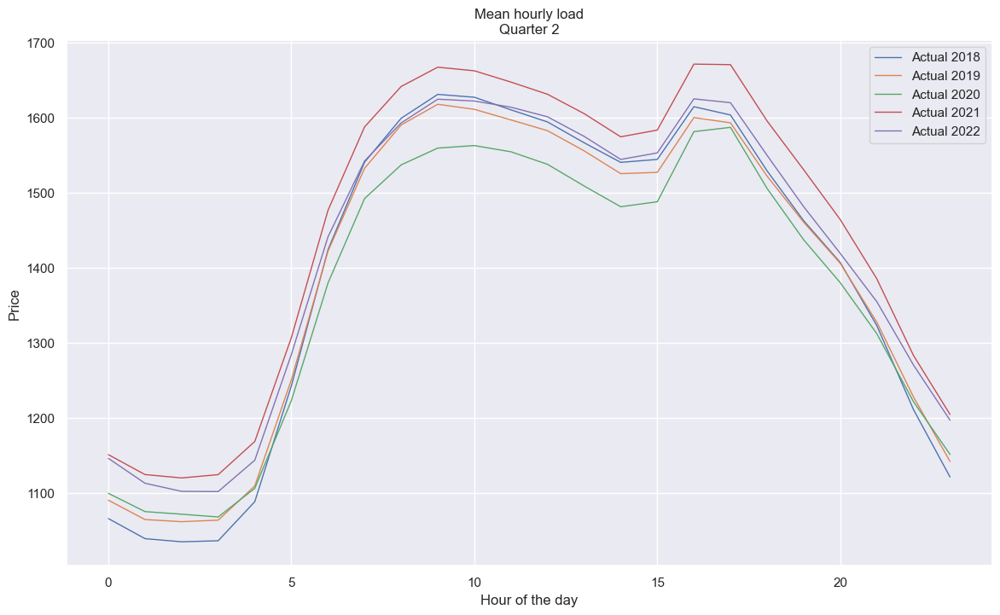

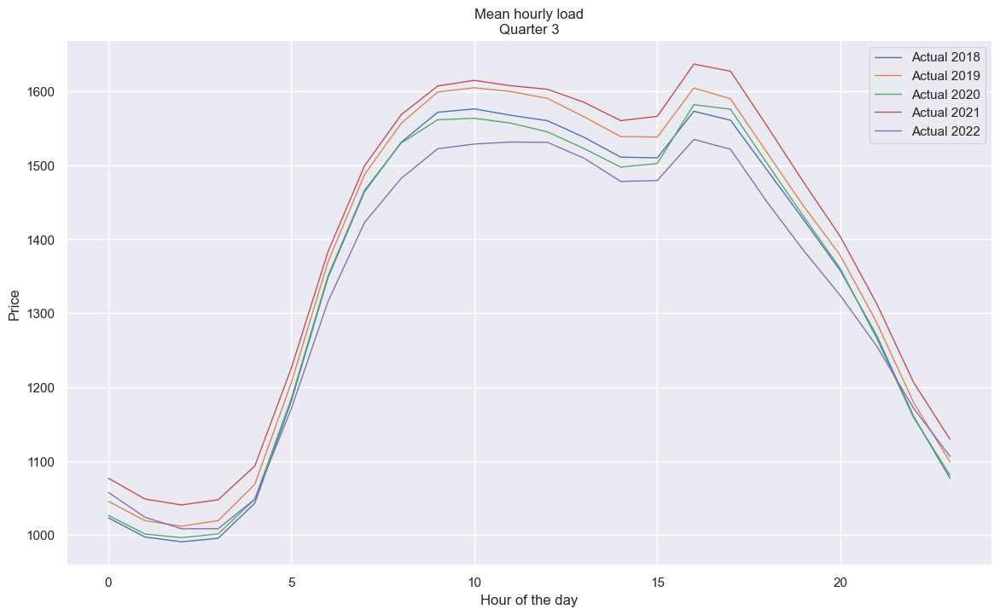

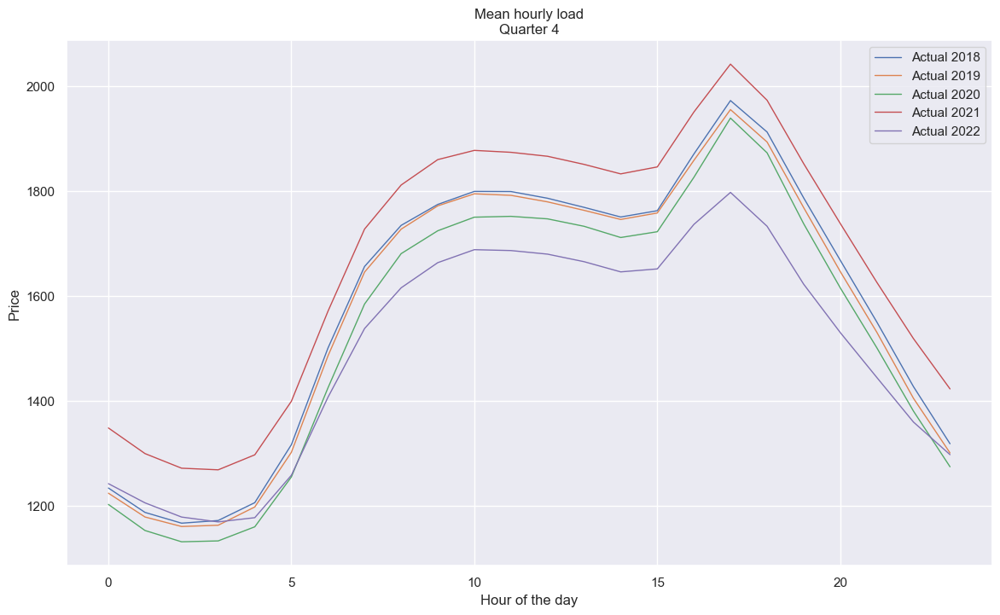

In [78]:
for q in quarters:
    for y in years:
        temp = df2[(df2['Year'] == y) & (df2['Quarter'] == q)].reset_index()
        temp = temp.groupby('Hour').mean(numeric_only = True)
        plt.plot(temp['Actual_Load'], linestyle = '-', linewidth = 1, label = 'Actual ' + str(y))
#         plt.plot(temp['Forecasted Load'], linestyle = '--', linewidth = 1, label = 'Forecasted' + str(y))
    plt.legend()
    plt.title('Mean hourly load\nQuarter '+str(q))
    plt.xlabel('Hour of the day')
    plt.ylabel('Price')
    plt.show()

## Day Ahead Price and Wind Total Production

We could assume with a degree of accuracy that it follows a logarithmic distribution

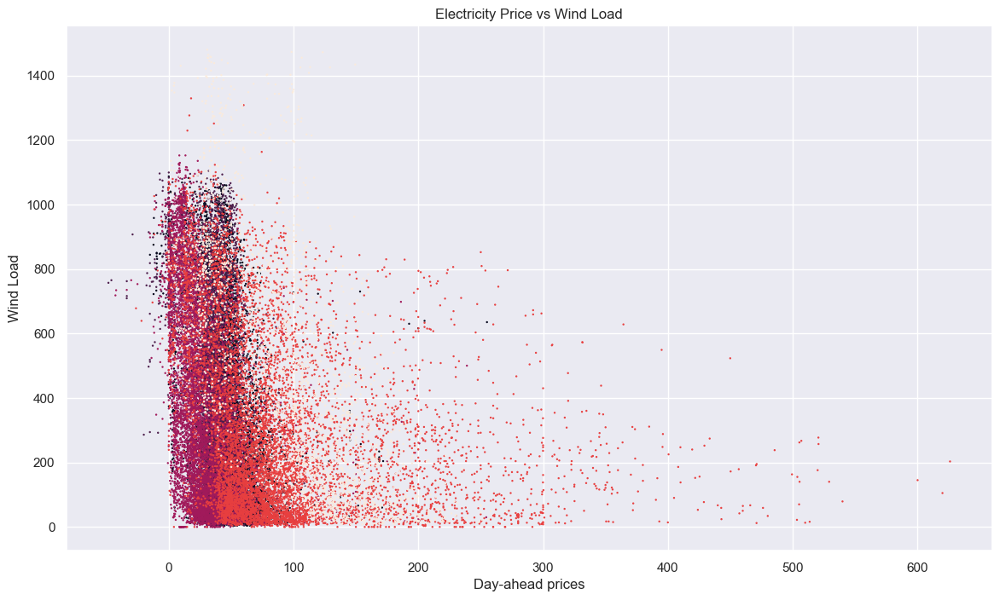

In [81]:
# Scatter plot of electricity price and wind load
df_masked = df[df['Year'] != 2022]
plt.scatter(df_masked['Day_Ahead_price'], df_masked['Wind Total'], s = 0.5, c = df_masked['Year'])
plt.xlabel('Day-ahead prices')
plt.ylabel('Wind Load')
plt.title('Electricity Price vs Wind Load')
plt.show()

In [4]:
## Plotting the average Price per Month for all years


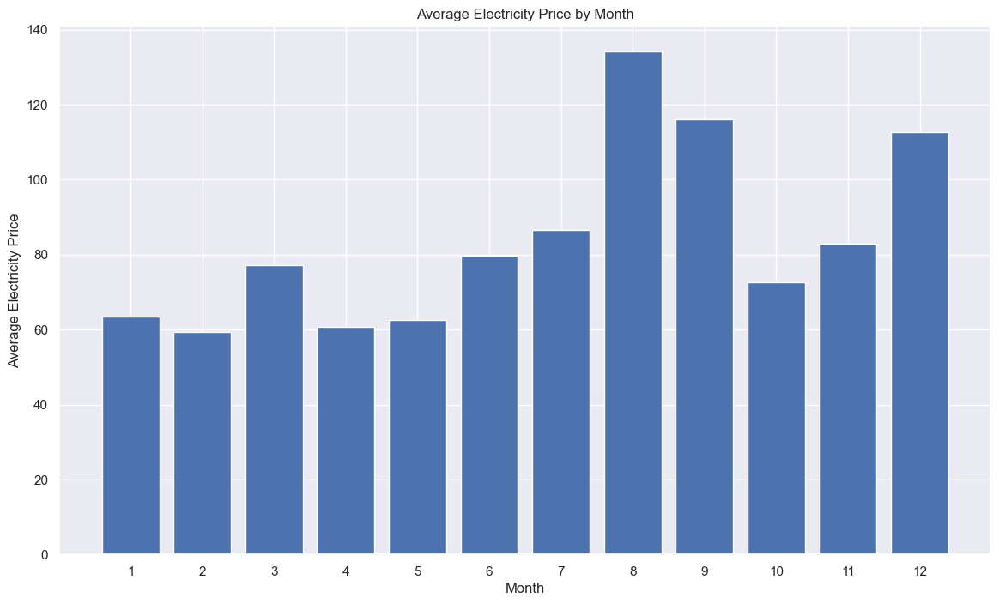

In [82]:
# DISAGGREGATE PER YEAR
# Bar chart of average electricity price for each month
monthly_average = df.groupby(by = 'Month')['Day_Ahead_price'].mean()
plt.bar(monthly_average.index, monthly_average.values)
plt.xticks(range(1, 13))
plt.xlabel('Month')
plt.ylabel('Average Electricity Price')
plt.title('Average Electricity Price by Month')
plt.show()

In [84]:
from functions import *

In [85]:
years = [2018, 2019, 2020, 2021, 2022]
attributes = ['Day_Ahead_price', 'Forecasted_Load', 'Biomass_Actual_Aggregated_[MW]', 'Waste_Actual_Aggregated_[MW]', 'Actual_Load', 'ttf_price', 'Solar_[MW]', 'Wind Total']

In [86]:
# Iteration yearly for some specific attributes and calculation of the summary statistics
for year in years:
    for attribute in attributes:
        # Create a new dataframe for the year and attribute
        df_year_attribute = split_dataset(df, year, attribute)
        
        # Calculate the summary statistics
        mean = df_year_attribute.mean()[0]
        median = df_year_attribute.median()[0]
        std = df_year_attribute.std()[0]
        minimum = df_year_attribute.min()[0]
        maximum = df_year_attribute.max()[0]
        
        # Print the summary statistics
        print(f"Hourly summary statistics for year {year} and attribute '{attribute}':")
        print(f"Mean: {mean:.2f}")
        print(f"Median: {median:.2f}")
        print(f"Standard deviation: {std:.2f}")
        print(f"Minimum: {minimum:.2f}")
        print(f"Maximum: {maximum:.2f}")
        print("\n")

Hourly summary statistics for year 2018 and attribute 'Day_Ahead_price':
Mean: 46.54
Median: 48.11
Standard deviation: 7.11
Minimum: 34.88
Maximum: 55.84


Hourly summary statistics for year 2018 and attribute 'Forecasted_Load':
Mean: 1513.23
Median: 1637.30
Standard deviation: 246.62
Minimum: 1110.23
Maximum: 1793.12


Hourly summary statistics for year 2018 and attribute 'Biomass_Actual_Aggregated_[MW]':
Mean: 244.87
Median: 253.46
Standard deviation: 15.63
Minimum: 218.19
Maximum: 261.41


Hourly summary statistics for year 2018 and attribute 'Waste_Actual_Aggregated_[MW]':
Mean: 50.50
Median: 51.00
Standard deviation: 1.20
Minimum: 48.38
Maximum: 51.83


Hourly summary statistics for year 2018 and attribute 'Actual_Load':
Mean: 1513.95
Median: 1636.98
Standard deviation: 243.99
Minimum: 1123.48
Maximum: 1800.46


Hourly summary statistics for year 2018 and attribute 'ttf_price':
Mean: 22.32
Median: 22.32
Standard deviation: 0.00
Minimum: 22.32
Maximum: 22.34


Hourly summary statis

## Hourly Price for all the years one by one

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


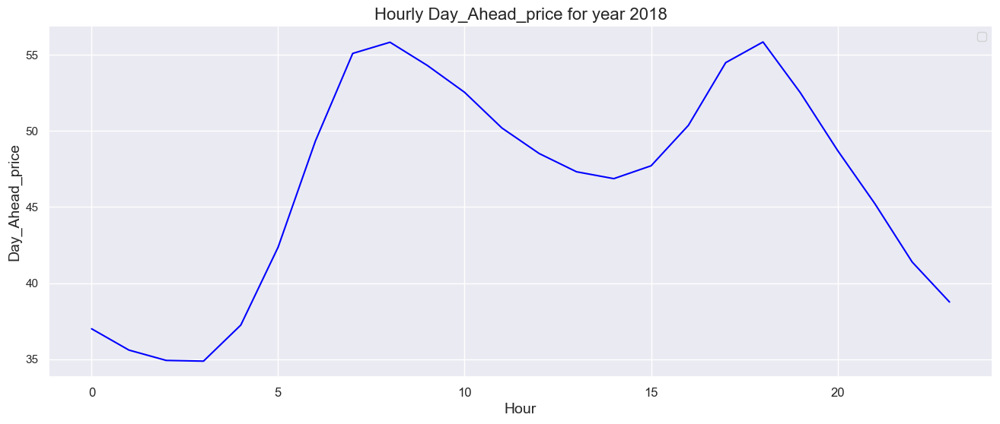

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


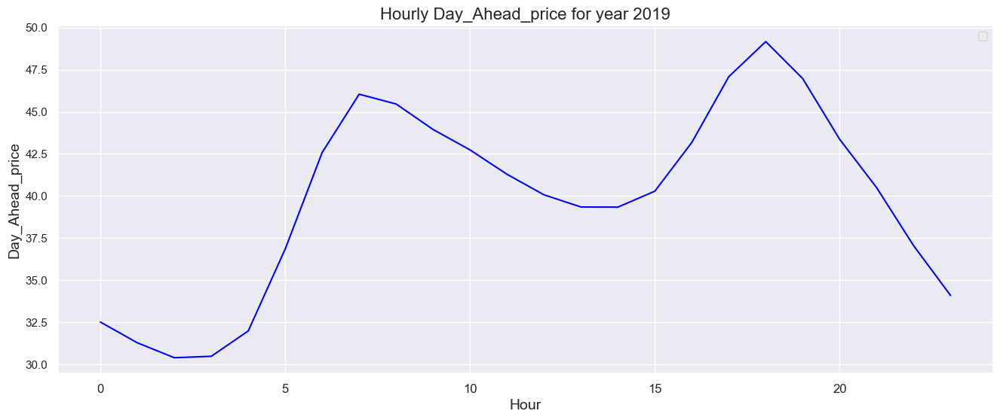

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


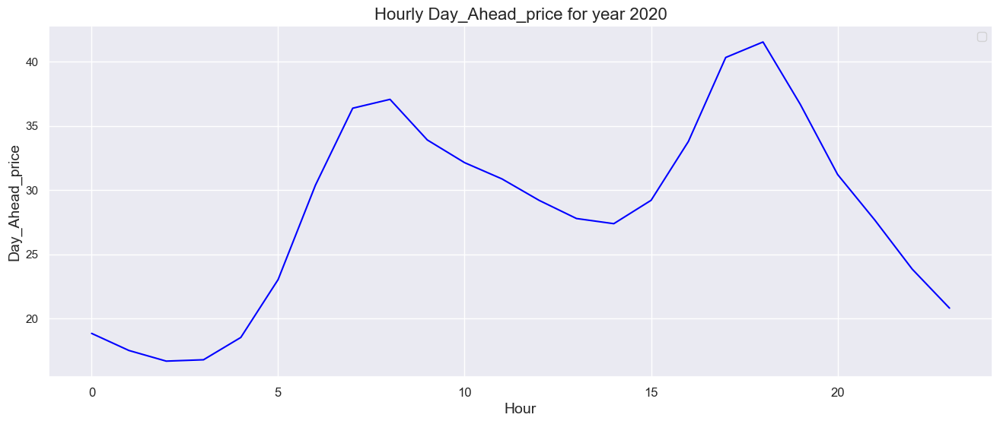

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


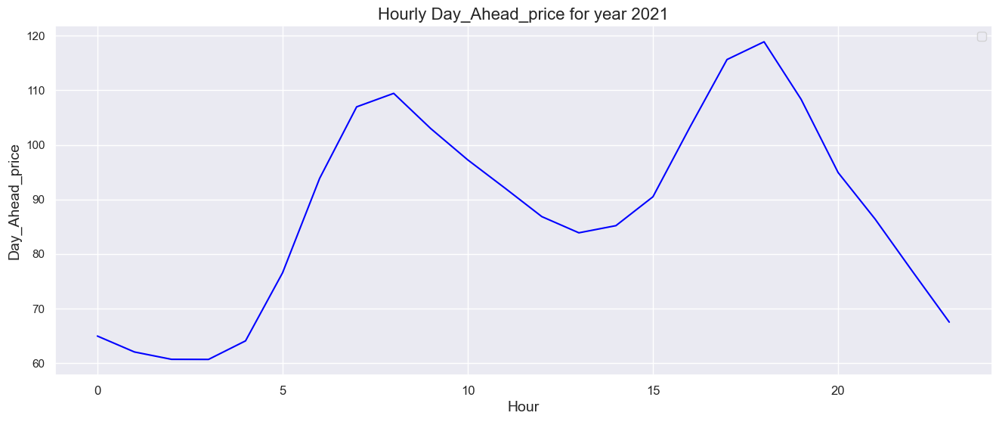

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


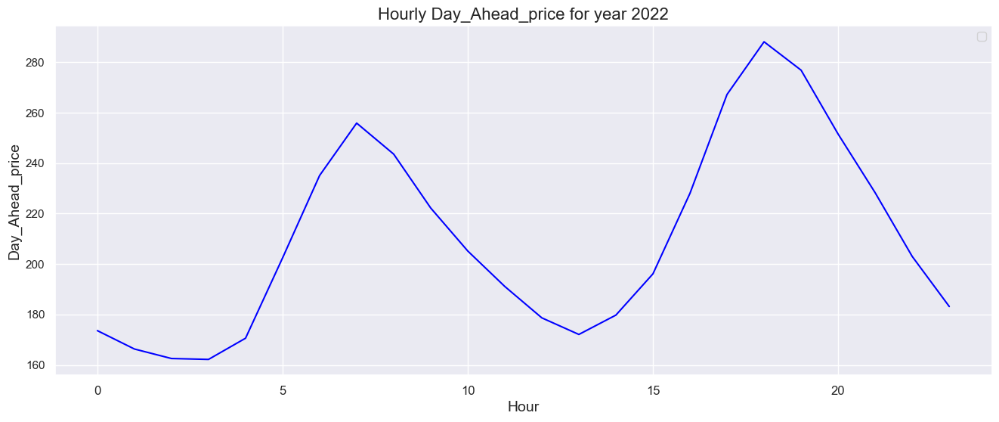

In [90]:
for yr in years:
    plot_hourly_data(df, yr, 'Day_Ahead_price')